<a href="https://colab.research.google.com/github/dlai211/Emulsion-IFT-Matching/blob/main/Matching_v2_(Match).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import Module

In [2]:
# For Colab Only
!pip install uproot awkward lmfit
from google.colab import drive
drive.mount('/content/drive', force_remount=True)


In [ ]:
import uproot, scipy, math, os, random, time, pickle, collections
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import awkward as ak
from tqdm import tqdm
import pandas as pd
from scipy import stats
from scipy.spatial.distance import cdist
from lmfit.models import GaussianModel

# Emulsion Data Pre-processing

In [3]:
emu = pd.read_csv("emulsion_data/chk_trks_F221_zone1_p200-210_test_50000_50000_pm11000.txt", sep='\s+', header=None)
emu.columns = ["t->ID", "plate_first", "plate_last", "x1", "y1", "z1", "x", "y", "z", 
               'tx1', 'ty1', "tx", "ty", "ty_pos", "tx_pos", "t->N()", "t->Npl()"]
emu = emu[emu["plate_last"] > 208] # save last two layers
emu

,t->ID,plate_first,plate_last,x1,y1,z1,x,y,z,tx1,ty1,tx,ty,ty_pos,tx_pos,t->N(),t->Npl()
2,4,201,209,39041.1,39182.8,-12245.4,39324.3,39830.0,-1362.6,0.023672,0.061343,0.030153,0.047891,0.026019,0.059463,9,9
3,5,201,210,39126.6,39603.1,-12245.4,39025.7,39623.1,0.0,-0.008519,0.002485,-0.008319,0.001036,-0.008239,0.001635,10,10
4,6,201,210,39054.3,39774.1,-12245.4,39557.5,40066.4,0.0,0.042726,0.026021,0.041197,0.021605,0.041092,0.023874,10,10
5,7,201,210,39355.6,39748.1,-12245.4,39238.9,39777.2,0.0,-0.010265,0.003581,-0.004390,0.002283,-0.009535,0.002373,10,10
6,9,201,210,39305.6,39774.2,-12245.4,39217.4,39807.0,0.0,-0.006548,0.000378,-0.003540,0.002066,-0.007203,0.002675,10,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55674,93752,201,210,59940.4,56461.2,-12245.4,59802.1,56521.8,0.0,-0.010256,0.008423,-0.011749,0.005902,-0.011302,0.004947,10,10
55675,93753,201,210,41018.5,58507.9,-12245.4,40928.5,58531.0,0.0,-0.008445,0.001439,-0.006869,0.002127,-0.007350,0.001885,8,10
55676,93755,203,210,46471.4,57724.6,-9504.2,45619.7,58273.7,0.0,-0.087493,0.060183,-0.101307,0.058681,-0.089609,0.057771,6,8
55677,93757,201,210,50998.7,57543.2,-12245.4,50983.3,57565.3,0.0,0.000111,0.001490,-0.000167,0.001195,-0.001253,0.001809,9,10


In [3]:
'''
# For MC only
# Manually insert global z position
# 210th film, global z = -1950.27mm; 209th film, global z = -1951.63mm.

pl = np.array(emu['plate_last'])

z_tmp = np.where(pl == 210, -1950.27, np.where(pl == 209, -1951.63, np.nan)) 
'''

In [4]:
# Only save last two film information

emu = pd.DataFrame({
    # convert to x, y to mm and right position with respect to nominal LoS
    # the center of the emulsion (125, 150)mm is around the nominal LoS
    'x': emu.x/1e3 + 10, # emulsion is +10 mm to nominal LoS in x
    'y': emu.y/1e3 - 33, # emulsion is -33 mm to nominal LoS in y
    'tx': emu.tx,
    'ty': emu.ty
})
emu

,x,y,tx,ty
2,49.3243,6.8300,0.030153,0.047891
3,49.0257,6.6231,-0.008319,0.001036
4,49.5575,7.0664,0.041197,0.021605
5,49.2389,6.7772,-0.004390,0.002283
6,49.2174,6.8070,-0.003540,0.002066
...,...,...,...,...
55674,69.8021,23.5218,-0.011749,0.005902
55675,50.9285,25.5310,-0.006869,0.002127
55676,55.6197,25.2737,-0.101307,0.058681
55677,60.9833,24.5653,-0.000167,0.001195


# Tracking Station Pre-processing

In [5]:
# f_data = uproot.open('/content/drive/MyDrive/data/ForAli/match2.root')
f_data = uproot.open('/Users/aligarabaglu/Downloads/match2.root')

data = f_data['trackParam'].arrays(['fitParam_x',
                                    'fitParam_y',  
                                    'fitParam_z',
                                    'fitParam_px',
                                    'fitParam_py',
                                    'fitParam_pz',
                                    'fitParam_chi2',
                                    'fitParam_charge',
                                    'fitParam_nMeasurements',
                                    'fitParam_align_id',
                                    'fitParam_align_local_residual_x'], library='ak') 

In [6]:
# Set up plot defaults 
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = 11.0,8.0  # Roughly 11 cm wde by 8 cm high
mpl.rcParams['font.size'] = 12.0 # Use 12 point font

## Event/Track Selection (IFT Only)

In [7]:
# All event has one and only one track
# do NOT need ak.num to select number of track
cut = ak.where((ak.flatten(data['fitParam_z']) < -1880)&  # can use flatten, instead of firsts
               (ak.flatten(data['fitParam_chi2']) < 100)&
               (ak.flatten(data['fitParam_pz']) < 200*1e3))

In [8]:
ift = data[cut]

In [9]:
ift

<Array [{fitParam_x: [22.8], ... 0.00126]]}] type='860448 * {"fitParam_x": var *...'>

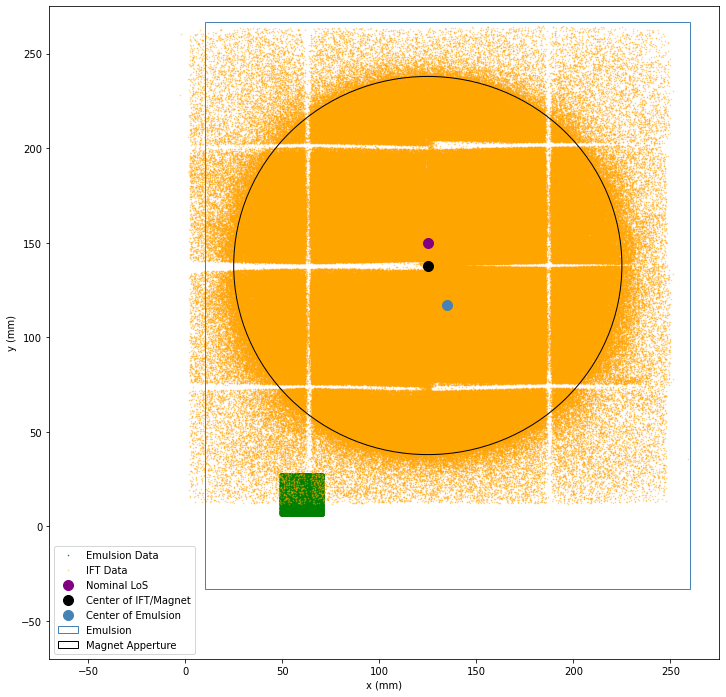

In [13]:
plt.figure(figsize=(12, 12))
plt.scatter(emu['x'], emu['y'], marker='.', color='green', s=1, label='Emulsion Data')
plt.scatter(ift['fitParam_x']+125, ift['fitParam_y']+138,  marker='.', color='orange', s=1, alpha=0.5, label='IFT Data')

plt.xlim(-70, 275)
plt.ylim(-70, 275)

from matplotlib.patches import Rectangle, Circle

# plot points
plt.scatter(125, 150, c='purple', s=100, label='Nominal LoS')
plt.scatter(125, 138, c='black', s=100, label='Center of IFT/Magnet')
plt.scatter(135, 117, c='steelblue', s=100, label='Center of Emulsion')

# plot rectangle
rect = Rectangle((135 - 125, 117 - 150), 250, 300, edgecolor='steelblue', facecolor='none', label='Emulsion')
plt.gca().add_patch(rect)

# plot circle
circle = Circle((125, 138), 100, edgecolor='black', facecolor='none', label='Magnet Apperture')
plt.gca().add_patch(circle)

# set axis limits and aspect ratio
plt.xlabel('x (mm)')
plt.ylabel('y (mm)')

# show plot
plt.legend()
plt.show()

In [16]:
# plt.figure(figsize=(12, 12))
# plt.scatter(emu['x'], emu['y'], marker='.', color='green', s=1, label='Emulsion Data')
# # plt.scatter(ift['fitParam_x']+125, ift['fitParam_y']+138,  marker='.', color='orange', s=1, alpha=0.5, label='IFT Data')
# plt.scatter(ift['fitParam_x']+115, ift['fitParam_y']+171,  marker='.', color='orange', s=1, alpha=0.5, label='IFT Data')

# plt.xlim(-70, 310)
# plt.ylim(-70, 310)

# from matplotlib.patches import Rectangle, Circle

# # plot points
# plt.scatter(115, 183, c='purple', s=100, label='Nominal LoS')
# plt.scatter(115, 171, c='black', s=100, label='Center of IFT/Magnet')
# plt.scatter(125, 150, c='steelblue', s=100, label='Center of Emulsion')

# # plot rectangle
# rect = Rectangle((0, 0), 250, 300, edgecolor='steelblue', facecolor='none', label='Emulsion')
# plt.gca().add_patch(rect)

# # plot circle
# circle = Circle((115, 171), 100, edgecolor='black', facecolor='none', label='Magnet Apperture')
# plt.gca().add_patch(circle)

# # set axis limits and aspect ratio
# plt.xlabel('x (mm)')
# plt.ylabel('y (mm)')

# # show plot
# plt.legend()
# plt.show()

# Tx & Ty

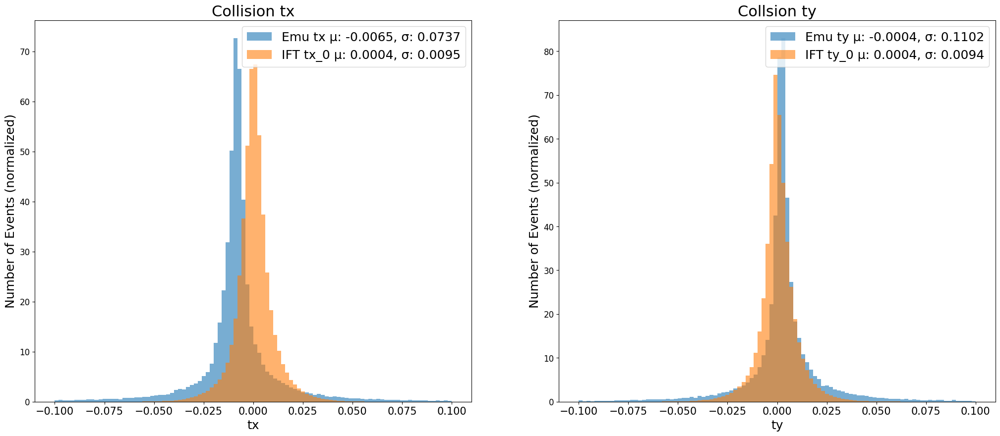

In [35]:
# tx
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
bin = np.linspace(-0.1, 0.1, 101)
round_num = 4
emutx_mean, emutx_std = round(np.mean(emu['tx']), round_num), round(np.std(emu['tx']), round_num)
plt.hist(emu['tx'], bins=bin, alpha=.6, density=True, label=f'Emu tx µ: {emutx_mean}, σ: {emutx_std}')

ift_tx, ift_ty = ak.flatten(ift['fitParam_px']/ift['fitParam_pz']), ak.flatten(ift['fitParam_py']/ift['fitParam_pz'])
ifttx_mean, ifttx_std = round(np.mean(ift_tx), round_num), round(np.std(ift_tx), round_num)
plt.hist(ift_tx, bins=bin, alpha=.6, density=True, label=f'IFT tx_0 µ: {ifttx_mean}, σ: {ifttx_std}')

#emurot_mean, emurot_std = round(np.mean(emu_rot['tx']), round_num), round(np.std(emu_rot['tx']), round_num)
#plt.hist(emu_rot['tx'], bins=bin, alpha=0.round_num, density=True, label=f'Emu (rotated) tx µ: {round(emurot_mean, 5)}, σ: {emurot_std}')

plt.xlabel('tx', fontsize=18)
plt.ylabel('Number of Events (normalized)', fontsize=18)
plt.title('Collision tx', fontsize=22)
plt.xticks(fontsize=15)
plt.legend(fontsize=18)

# ty
plt.subplot(1, 2, 2)
emuty_mean, emuty_std = round(np.mean(emu['ty']), round_num), round(np.std(emu['ty']), round_num)
plt.hist(emu['ty'], bins=bin, alpha=.6, density=True, label=f'Emu ty µ: {emuty_mean}, σ: {emuty_std}')

iftty_mean, iftty_std = round(np.mean(ift_ty), round_num), round(np.std(ift_ty), round_num)
plt.hist(ift_ty, bins=bin, alpha=.6, density=True, label=f'IFT ty_0 µ: {iftty_mean}, σ: {iftty_std}')

#emurot_mean, emurot_std = round(np.mean(emu_rot['ty']), round_num), round(np.std(emu_rot['ty']), round_num)
#plt.hist(emu_rot['ty'], bins=bin, alpha=0.round_num, density=True, label=f'Emu (rotated) ty µ: {round(emurot_mean, 5)}, σ: {emurot_std}')

plt.xlabel('ty', fontsize=18)
plt.ylabel('Number of Events (normalized)', fontsize=18)
plt.title('Collsion ty', fontsize=22)
plt.xticks(fontsize=15)
plt.legend(fontsize=18)
plt.show()

# Initial Rotation: angle alignment for emulsion to match IFT (Missing)

# Extrapoluation (Emulsion -> IFT)
 - ## no magnetic field (straight line prediction)

In [41]:
# distance from IFT to emulsion in MC [mm]
# DistEmuIft = 55.5

# distance from IFT to emulsion in collsion data [mm]
DistEmuIft = 63.4

# center of tracking station with respect to nominal Line Of Sight (LOS) [mm]
y_los = 138
x_los = 125

# Z position of module 0 and 2, which is smallest z position in IFT 1st layer
module0_z = -1898.0509 # mm

# Z position of module 4 and 6, which is largest z position in IFT 1st layer
module4_z = -1886.1353 # mm

# Transformation for IFT
y_tran = ak.flatten(ift['fitParam_y']) + y_los 
x_tran = ak.flatten(ift['fitParam_x']) + x_los

'''
# IFT to Emulsion Extrapolation
iftFront_z = -1898.05 # frontest IFT z position

def ift2emu(x, y, z, px, py, pz):
    tx = px/pz
    ty = py/pz

    # Extrapolation
    Dist_tot = DistEmuIft + (z - iftFront_z)
    x_pred = Dist_tot * (-tx) + x
    y_pred = Dist_tot * (-ty) + y
    return x_pred, y_pred

ift_x_pred, ift_y_pred = ift2emu(x_tran, y_tran, ak.flatten(ift['fitParam_z']), ak.flatten(ift['fitParam_px']), ak.flatten(ift['fitParam_py']), ak.flatten(ift['fitParam_pz']))
'''

# Emulsion to IFT Extrapolation
# Step 1: Emulsion to IFT module 4
def emu2ift(x, y, tx, ty):
    Dist_tot = DistEmuIft + np.abs(module0_z - module4_z)
    x_pred = Dist_tot * tx + x
    y_pred = Dist_tot * ty + y
    return x_pred, y_pred

emu_x_pred, emu_y_pred = emu2ift(emu['x'], emu['y'], emu['tx'], emu['ty'])

def ift2ift(x, y, z, tx, ty):
    Dist_tot = np.abs(z - module4_z)
    x_pred = Dist_tot * tx + x
    y_pred = Dist_tot * ty + y
    return x_pred, y_pred

ift_x_pred, ift_y_pred = ift2ift(x_tran, y_tran, ak.flatten(ift['fitParam_z']), ift_tx, ift_ty)

/usr/local/lib/python3.9/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


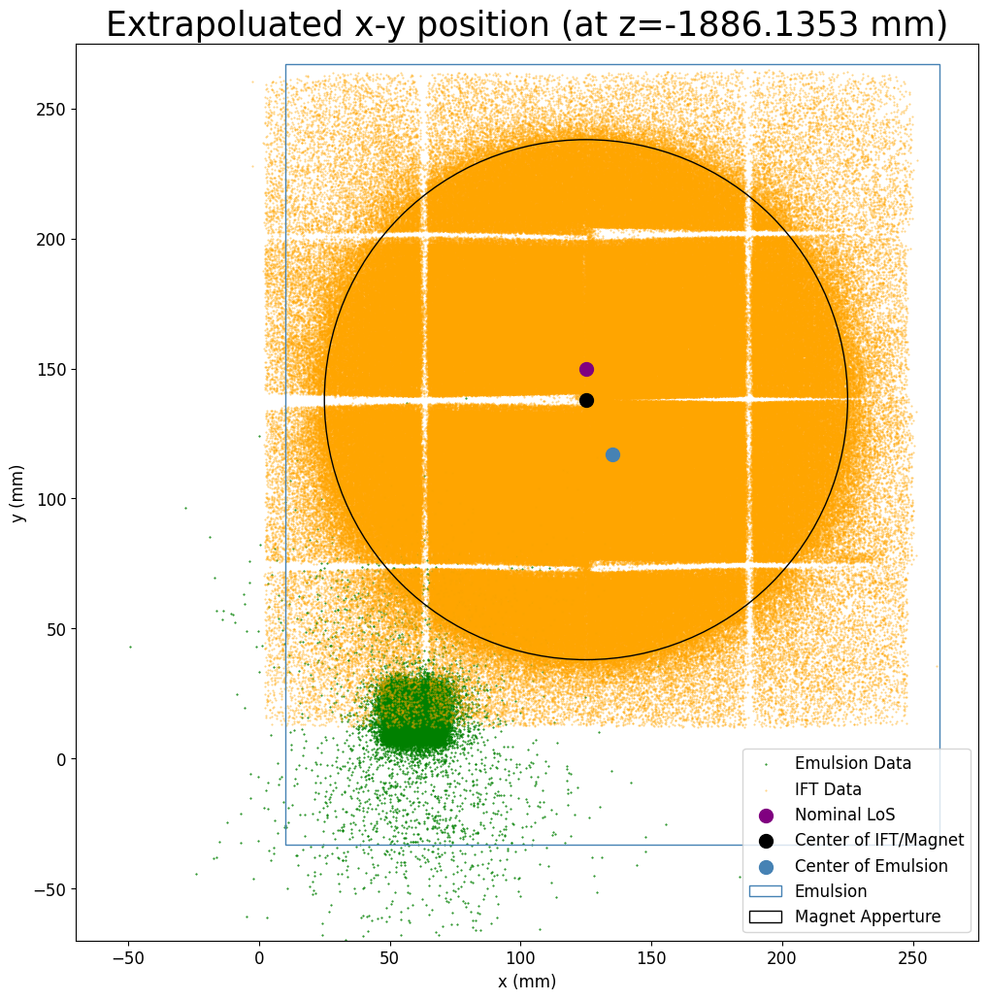

In [33]:
# Checking
plt.figure(figsize=(12, 12))
plt.scatter(emu_x_pred, emu_y_pred, marker='.', color='green', s=1, label='Emulsion Data')
plt.scatter(ift_x_pred, ift_y_pred,  marker='.', color='orange', s=1, alpha=0.5, label='IFT Data')
plt.xlim(-70, 275)
plt.ylim(-70, 275)

from matplotlib.patches import Rectangle, Circle

# plot points
plt.scatter(125, 150, c='purple', s=100, label='Nominal LoS')
plt.scatter(125, 138, c='black', s=100, label='Center of IFT/Magnet')
plt.scatter(135, 117, c='steelblue', s=100, label='Center of Emulsion')

# plot rectangle
rect = Rectangle((135 - 125, 117 - 150), 250, 300, edgecolor='steelblue', facecolor='none', label='Emulsion')
plt.gca().add_patch(rect)

# plot circle
circle = Circle((125, 138), 100, edgecolor='black', facecolor='none', label='Magnet Apperture')
plt.gca().add_patch(circle)

# set axis limits and aspect ratio
plt.xlabel('x (mm)')
plt.ylabel('y (mm)')
plt.title('Extrapoluated x-y position (at z=-1886.1353 mm)', fontsize=25)

# show plot
plt.legend()
plt.show()

In [48]:
# Organize the data
IFT = pd.DataFrame({
    'x': ift_x_pred,
    'y': ift_y_pred,
    'tx': ift_tx, 
    'ty': ift_ty
})

Emu = pd.DataFrame({
    'x': emu_x_pred,
    'y': emu_y_pred,
    'tx': emu['tx'] + np.abs(emutx_mean - ifttx_mean), # since the rotation code has not been debugged, this will reduce the error as well. Official Matching code will include the correct angle rotation
    'ty': emu['ty'] + np.abs(emuty_mean - iftty_mean)
})

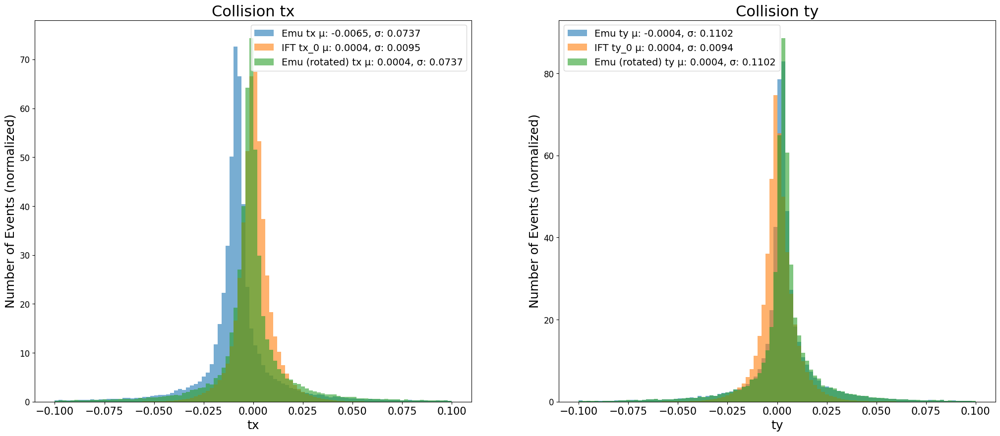

In [50]:
# tx
plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
bin = np.linspace(-0.1, 0.1, 101)
round_num = 4
emutx_mean, emutx_std = round(np.mean(emu['tx']), round_num), round(np.std(emu['tx']), round_num)
plt.hist(emu['tx'], bins=bin, alpha=.6, density=True, label=f'Emu tx µ: {emutx_mean}, σ: {emutx_std}')

ift_tx, ift_ty = ak.flatten(ift['fitParam_px']/ift['fitParam_pz']), ak.flatten(ift['fitParam_py']/ift['fitParam_pz'])
ifttx_mean, ifttx_std = round(np.mean(ift_tx), round_num), round(np.std(ift_tx), round_num)
plt.hist(ift_tx, bins=bin, alpha=.6, density=True, label=f'IFT tx_0 µ: {ifttx_mean}, σ: {ifttx_std}')

emurot_mean, emurot_std = round(np.mean(Emu['tx']), round_num), round(np.std(Emu['tx']), round_num)
plt.hist(Emu['tx'], bins=bin, alpha=.6, density=True, label=f'Emu (rotated) tx µ: {round(emurot_mean, 5)}, σ: {emurot_std}')

plt.xlabel('tx', fontsize=18)
plt.ylabel('Number of Events (normalized)', fontsize=18)
plt.title('Collision tx', fontsize=22)
plt.xticks(fontsize=15)
plt.legend(fontsize=14)

plt.subplot(1, 2, 2)
emuty_mean, emuty_std = round(np.mean(emu['ty']), round_num), round(np.std(emu['ty']), round_num)
plt.hist(emu['ty'], bins=bin, alpha=.6, density=True, label=f'Emu ty µ: {emuty_mean}, σ: {emuty_std}')

ift_ty, ift_ty = ak.flatten(ift['fitParam_px']/ift['fitParam_pz']), ak.flatten(ift['fitParam_py']/ift['fitParam_pz'])
iftty_mean, iftty_std = round(np.mean(ift_ty), round_num), round(np.std(ift_ty), round_num)
plt.hist(ift_ty, bins=bin, alpha=.6, density=True, label=f'IFT ty_0 µ: {iftty_mean}, σ: {iftty_std}')

emurot_mean, emurot_std = round(np.mean(Emu['ty']), round_num), round(np.std(Emu['ty']), round_num)
plt.hist(Emu['ty'], bins=bin, alpha=.6, density=True, label=f'Emu (rotated) ty µ: {round(emurot_mean, 5)}, σ: {emurot_std}')

plt.xlabel('ty', fontsize=18)
plt.ylabel('Number of Events (normalized)', fontsize=18)
plt.title('Collision ty', fontsize=22)
plt.xticks(fontsize=15)
plt.legend(fontsize=14)

# All Combinatorial Residual

In [75]:
# ty cut
ty_low_ift, ty_up_ift = -0.1, 0.1
ty_low_emu, ty_up_emu = -0.1, 0.1

emu_filter = Emu[(Emu['ty'] > ty_low_emu) & (Emu['ty'] < ty_up_emu)]
ift_filter = IFT[(IFT['ty'] > ty_low_ift) & (IFT['ty'] < ty_up_ift) &\
                   (IFT['y'] > 10) & (IFT['y'] < 25) &\
                   (IFT['x'] > 52) & (IFT['x'] < 68)]

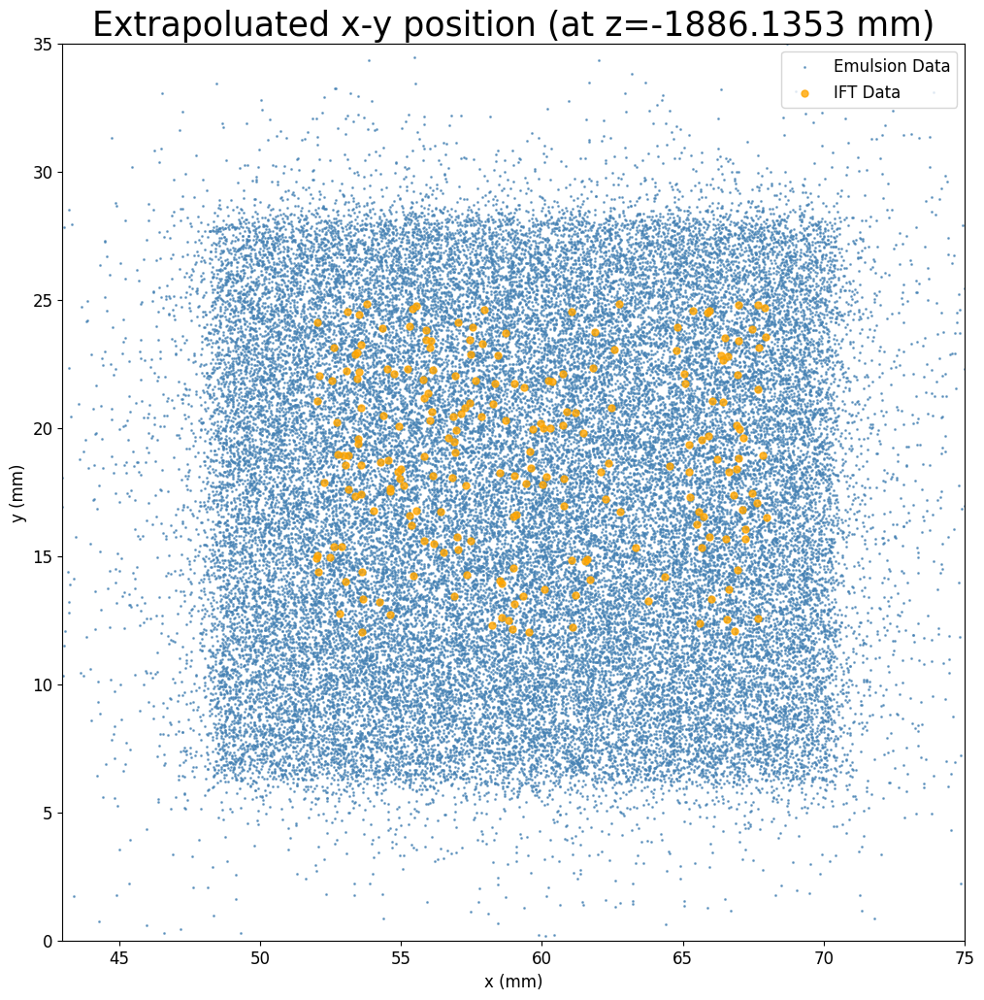

In [77]:
# Checking
plt.figure(figsize=(12, 12))
plt.scatter(emu_filter['x'], emu_filter['y'], marker='.', color='steelblue', s=4, alpha=0.7,  label='Emulsion Data')
plt.scatter(ift_filter['x'], ift_filter['y'],  marker='.', color='orange', s=100, alpha=0.8, label='IFT Data')
plt.xlim(43, 75)
plt.ylim(0, 35)

# set axis limits and aspect ratio
plt.xlabel('x (mm)')
plt.ylabel('y (mm)')
plt.title('Extrapoluated x-y position (at z=-1886.1353 mm)', fontsize=25)

# show plot
plt.legend()
plt.show()

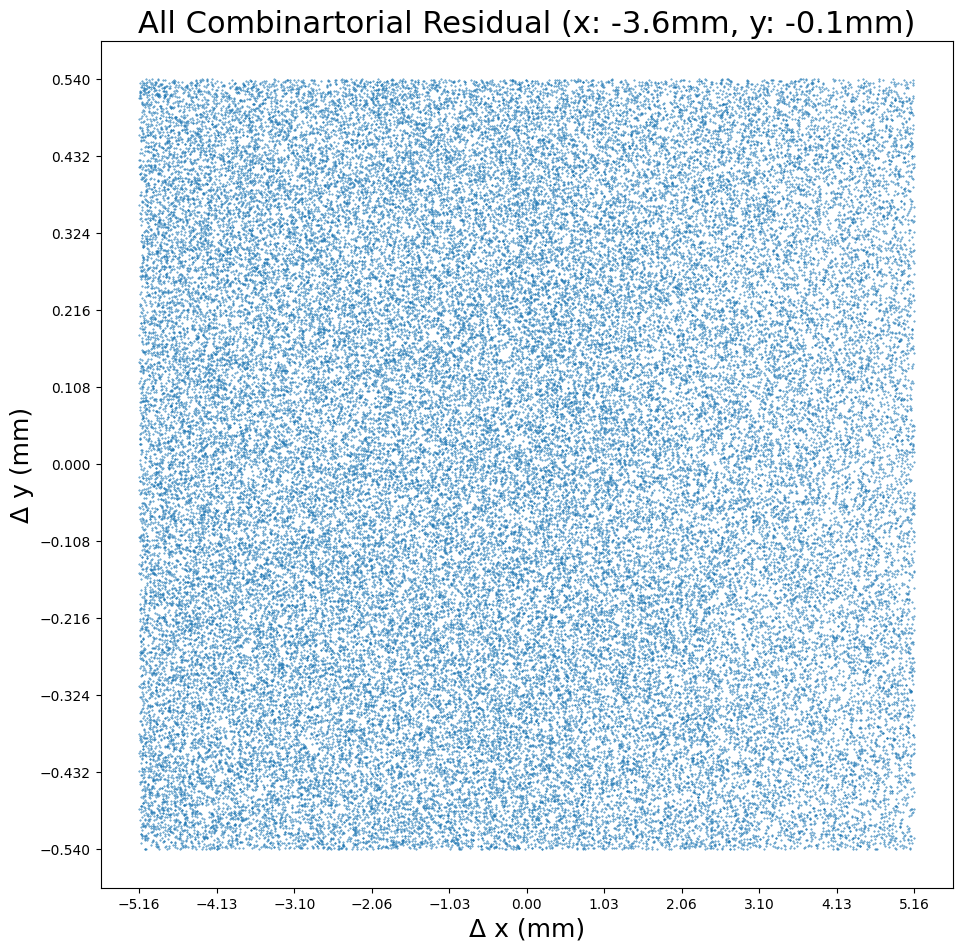

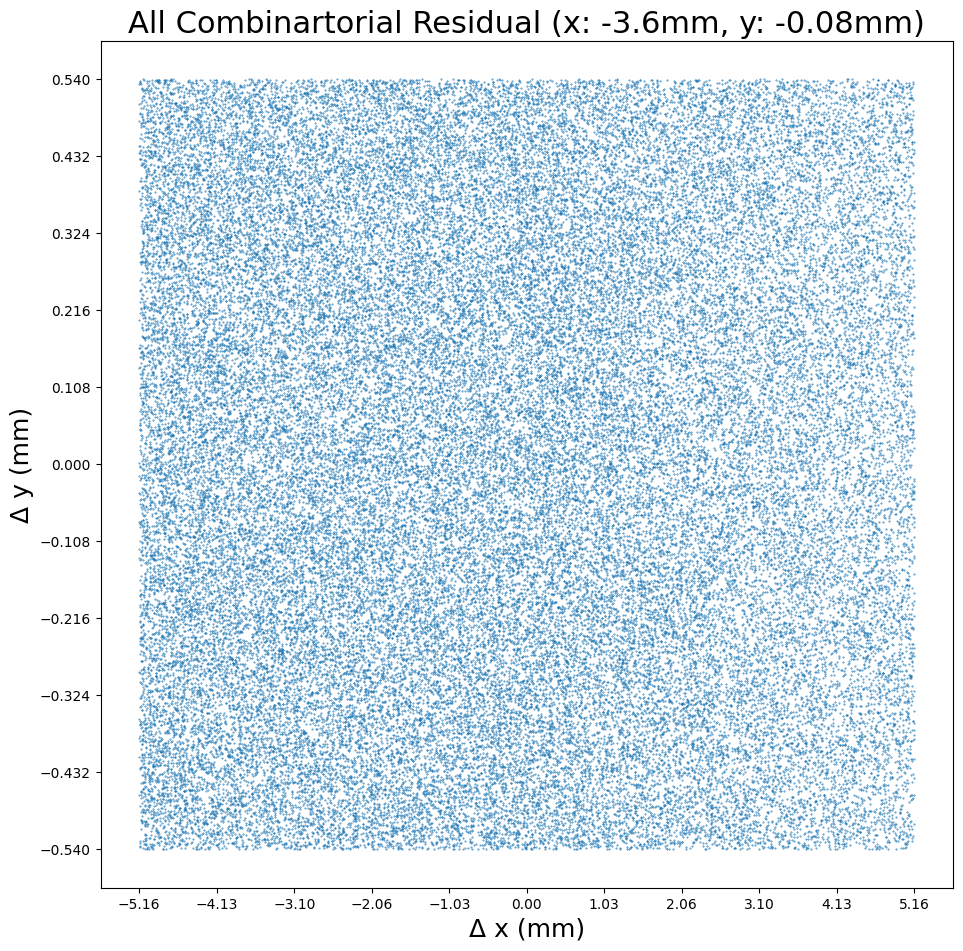

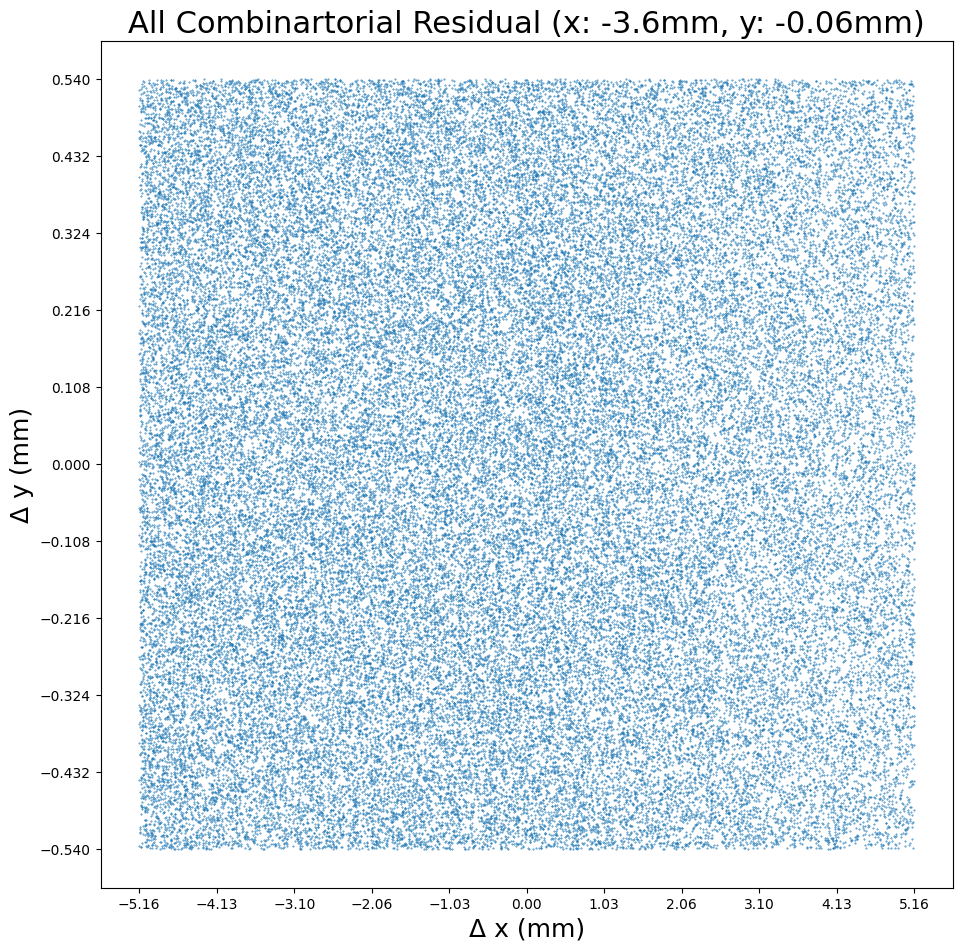

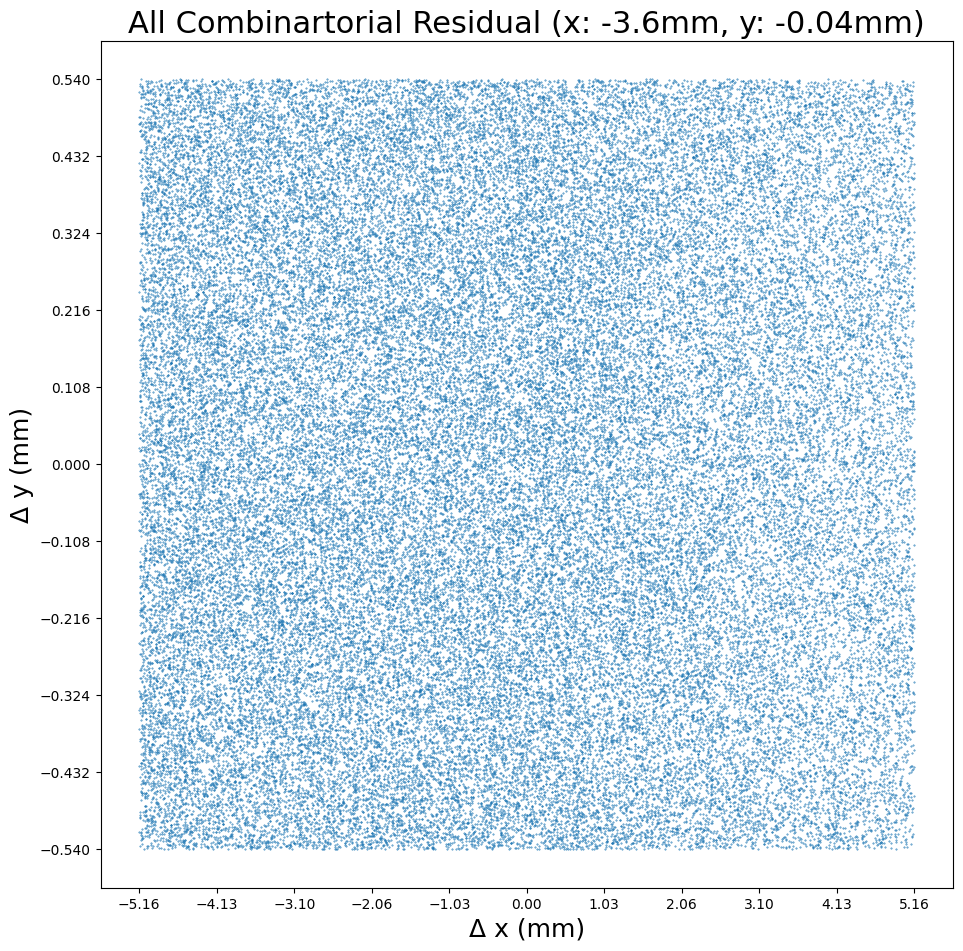

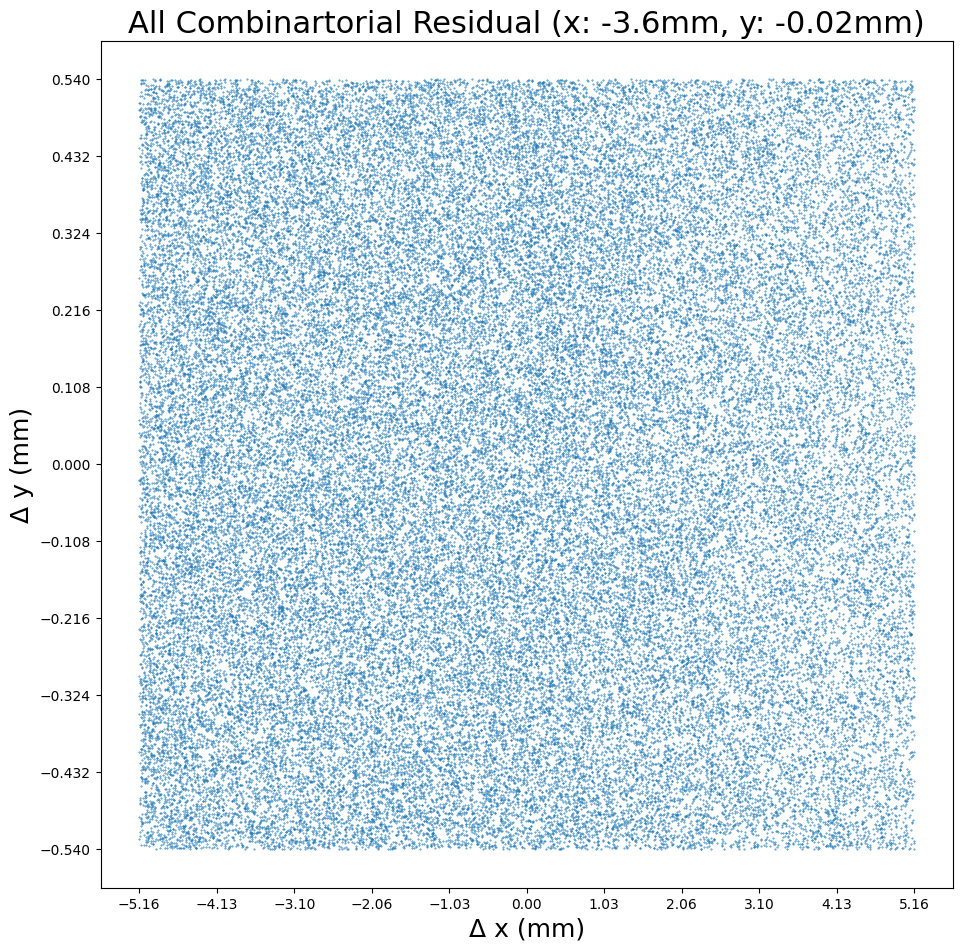

...

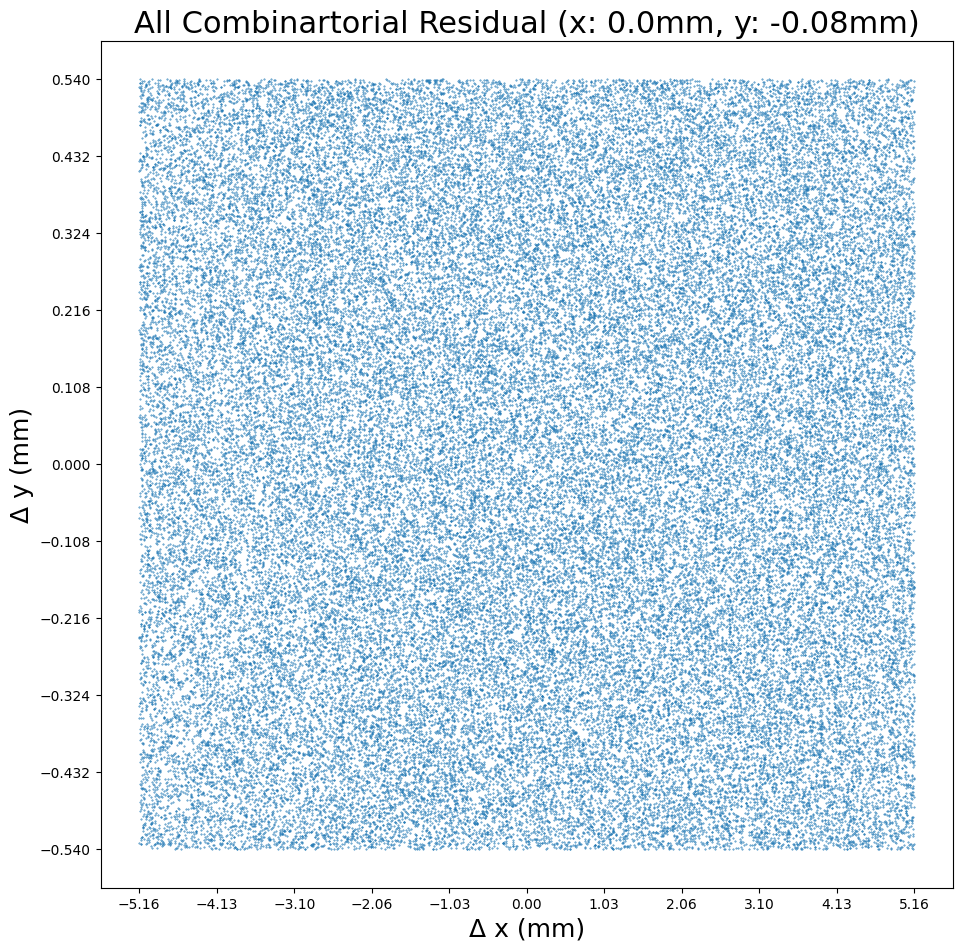

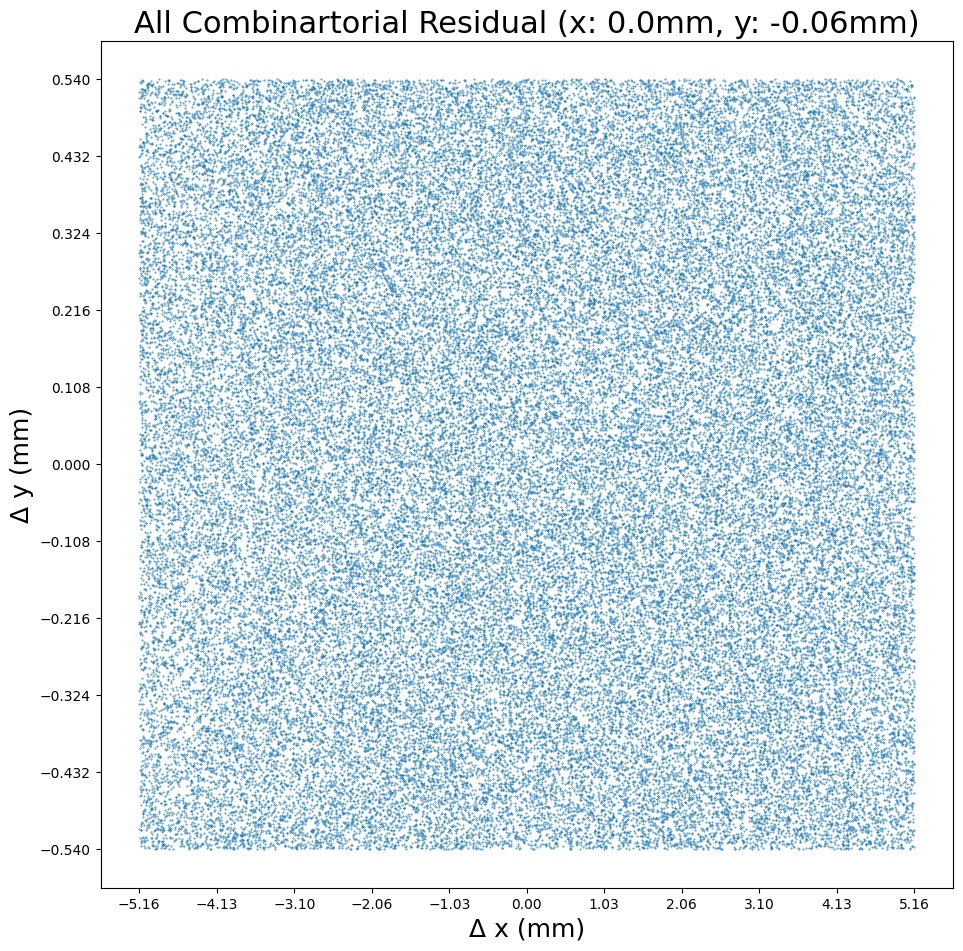

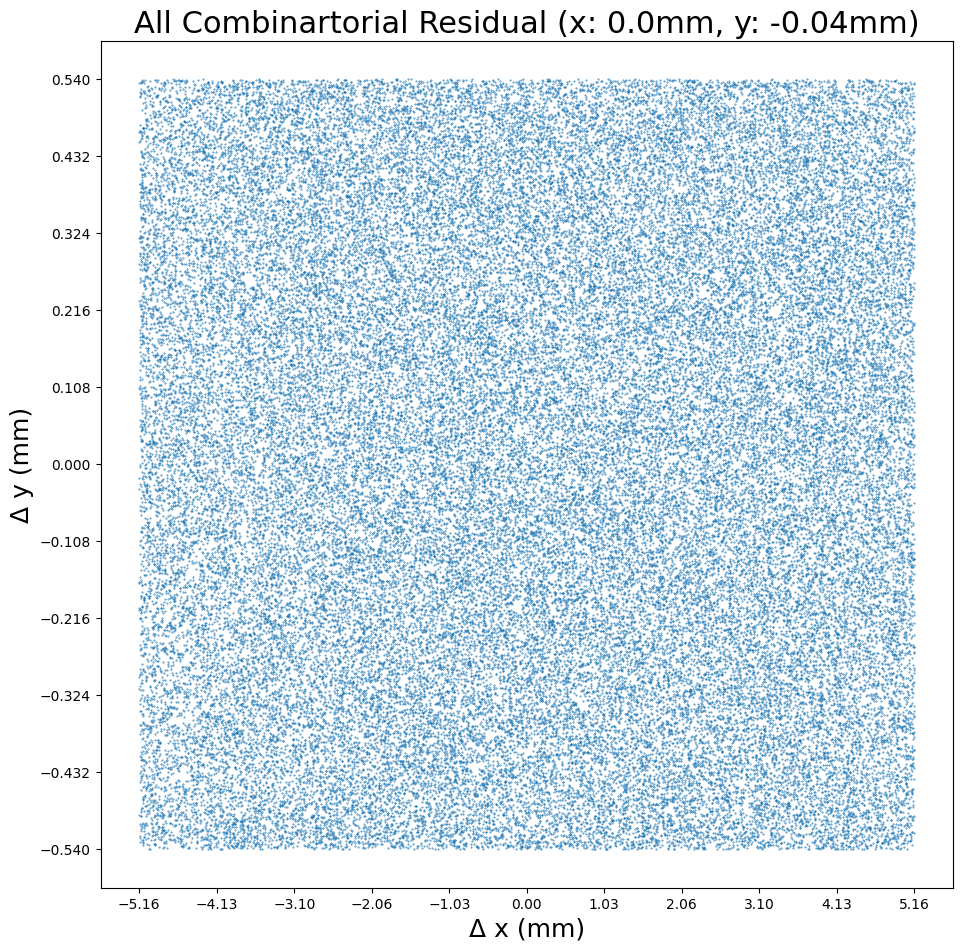

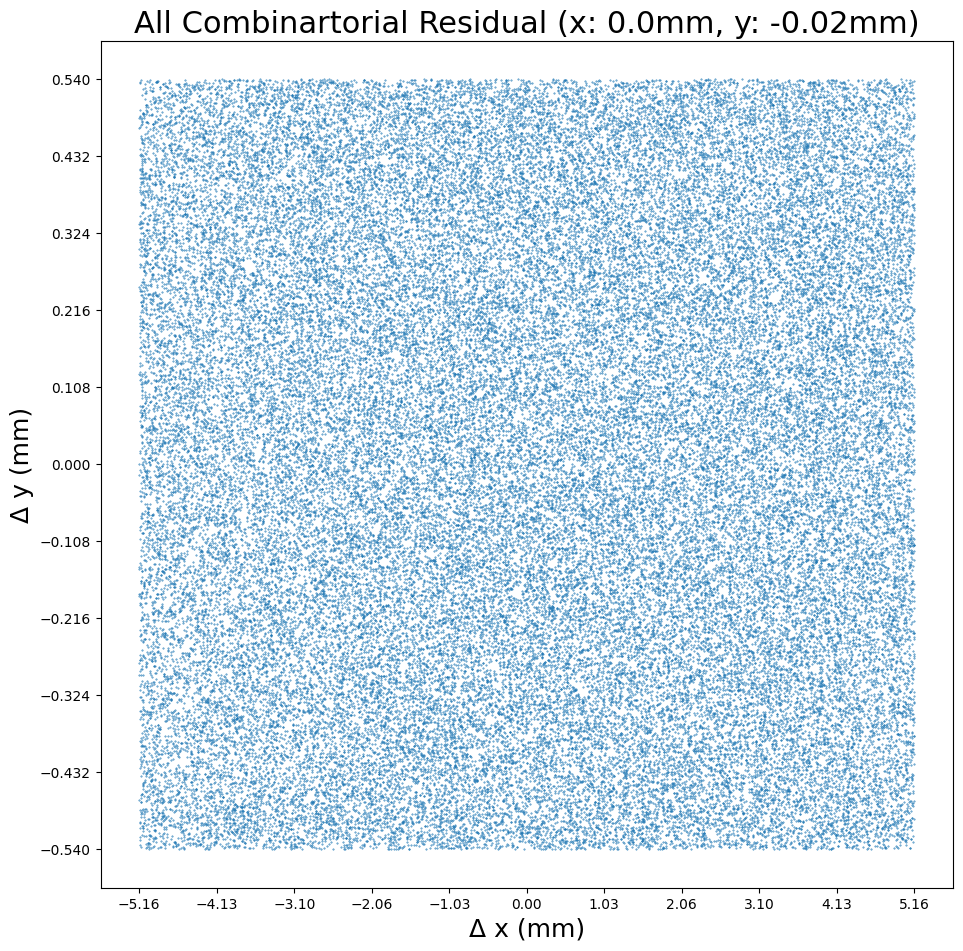

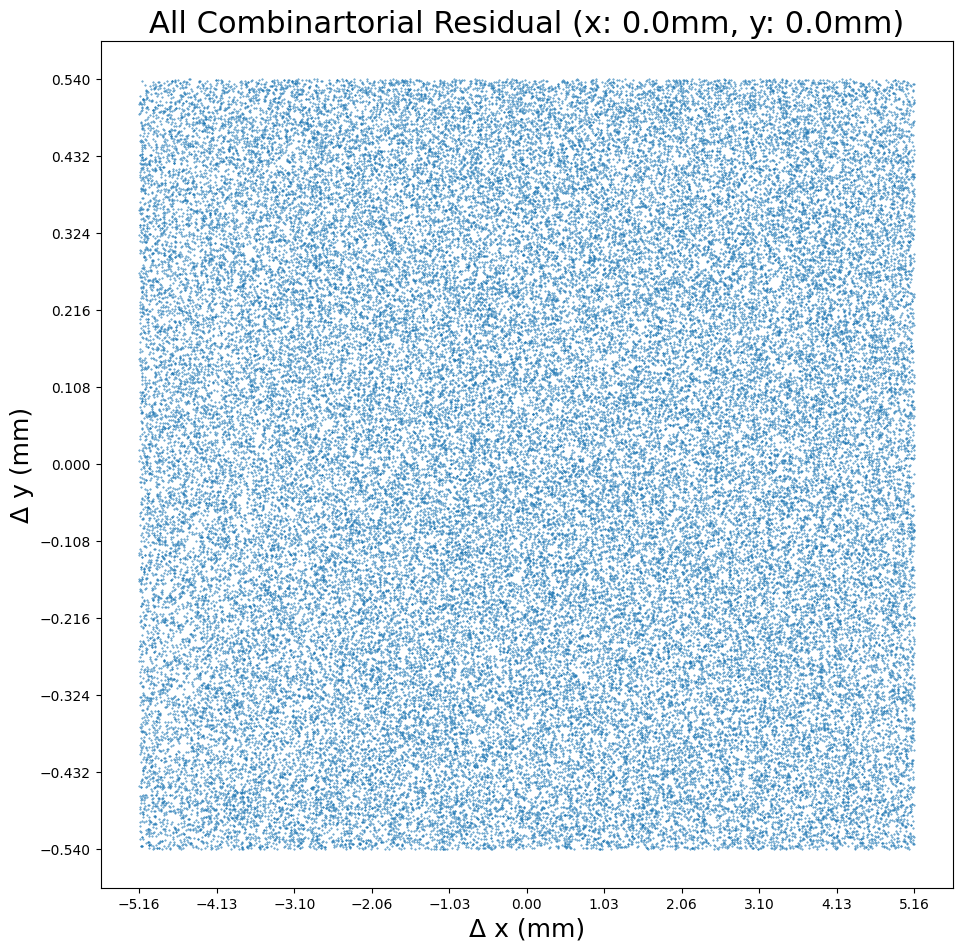

In [84]:
dx, dy = np.linspace(-3.6, 0, 5), np.linspace(-.1, 0, 6)
for i in range(len(dx)):
    for j in range(len(dy)):
        dy_tmp = ((np.array(ift_filter['y']) + dy[j]).reshape(len(ift_filter), 1) - np.array(emu_filter['y'])).flatten()
        dx_tmp = ((np.array(ift_filter['x']) + dx[i]).reshape(len(ift_filter), 1) - np.array(emu_filter['x'])).flatten()
        dtx_tmp = ((np.array(ift_filter['tx'])).reshape(len(ift_filter), 1) - np.array(emu_filter['tx'])).flatten()
        dty_tmp = ((np.array(ift_filter['ty'])).reshape(len(ift_filter), 1) - np.array(emu_filter['ty'])).flatten()
        
        m = pd.DataFrame({'x_res': dx_tmp, 'y_res': dy_tmp, 'tx_res': dtx_tmp, 'ty_res': dty_tmp})
        m = m[(abs(m['ty_res']) < 0.005) & (abs(m['x_res']) < 5.16) & (abs(m['y_res']) < .54)]


        plt.figure(figsize=(11, 11)) 

        dy_sel = m['y_res']
        dx_sel = m['x_res']
        plt.scatter(dx_sel, dy_sel, marker='.', s=.6)
        plt.xlabel(f'Δ x (mm)', fontsize=18)
        plt.ylabel(f'Δ y (mm)', fontsize=18)
        plt.title(f'All Combinartorial Residual (x: {round(dx[i], 2)}mm, y: {round(dy[j], 2)}mm)', fontsize=22)
        plt.xticks(np.linspace(-5.16, 5.16, 11), fontsize=10)
        plt.yticks(np.linspace(-.54, .54, 11), fontsize=10)
        #plt.legend(fontsize=15)

        plt.show()

# Chi2 Algorithm

In [91]:


emu_stack = np.stack(((emu_filter.x)/(1.7211), (emu_filter.y)/(0.01811), emu_filter.tx/(0.01406), emu_filter.ty/(0.00295)), axis=1)
ift_stack = np.stack(((ift_filter.x)/(1.7211), (ift_filter.y)/(0.01811), ift_filter.tx/(0.01406), ift_filter.ty/(0.00295)), axis=1)

t0 = time.time()
cdist_tot = cdist(ift_stack, emu_stack) # all ift point and all emu point
cdist_min = cdist(ift_stack, emu_stack).min(axis=-1)  # for each ift point, minimum chi2 for matching emu points
cdist_minpos = cdist(ift_stack, emu_stack).argmin(axis=-1)  # finding the position of emu with minimum chi2
pos_maxchi2 = ak.where(cdist_min < 20)[0]  # maximum chi2 = 20
cdist_minpos = cdist_minpos[pos_maxchi2]  # selecting mini position (above) with maximum chi2

dx_tmp = np.array(ift_filter.x)[pos_maxchi2] - np.array(emu_filter.x)[cdist_minpos]
dy_tmp = np.array(ift_filter.y)[pos_maxchi2] - np.array(emu_filter.y)[cdist_minpos]
dtx_tmp = np.array(ift_filter.tx)[pos_maxchi2] - np.array(emu_filter.tx)[cdist_minpos]
dty_tmp = np.array(ift_filter.ty)[pos_maxchi2] - np.array(emu_filter.ty)[cdist_minpos]
print('time:', time.time()-t0, 's')

time: 0.19213199615478516 s


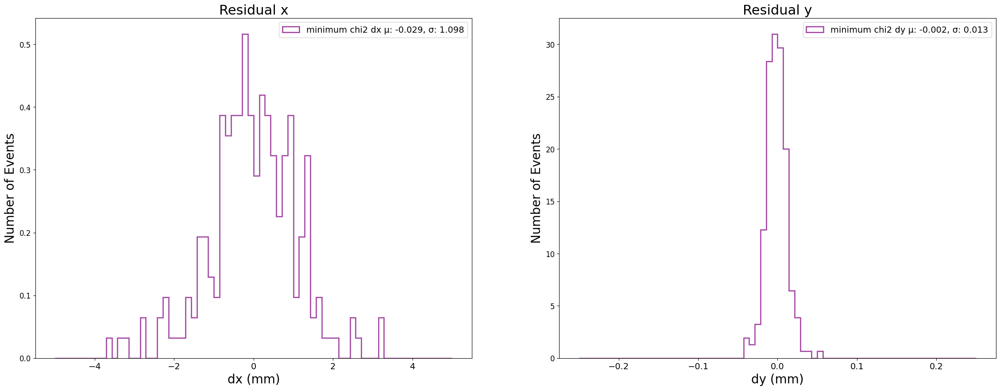

In [99]:
plt.figure(figsize=(28, 10))
plt.subplot(1, 2, 1)
bin = np.linspace(-5, 5, 71)
plt.hist(dx_tmp, bins=bin, alpha=0.7, histtype='step', linewidth=2, density=True, color='purple', label=f'minimum chi2 dx µ: {round(np.mean(dx_tmp), 3)}, σ: {round(np.std(dx_tmp), 3)}')
plt.title('Residual x', fontsize=22)
plt.ylabel('Number of Events', fontsize=20)
plt.xlabel('dx (mm)', fontsize=20)
plt.xticks(fontsize=14)
plt.legend(fontsize=14)

plt.subplot(1, 2, 2)
bin = np.linspace(-0.25, 0.25, 71)
plt.hist(dy_tmp, bins=bin, alpha=0.7, histtype='step', linewidth=2, density=True, color='purple', label=f'minimum chi2 dy µ: {round(np.mean(dy_tmp), 3)}, σ: {round(np.std(dy_tmp), 3)}')
plt.title('Residual y', fontsize=22)
plt.ylabel('Number of Events', fontsize=20)
plt.xlabel('dy (mm)', fontsize=20)
plt.xticks(fontsize=14)
plt.legend(fontsize=14)
plt.show()

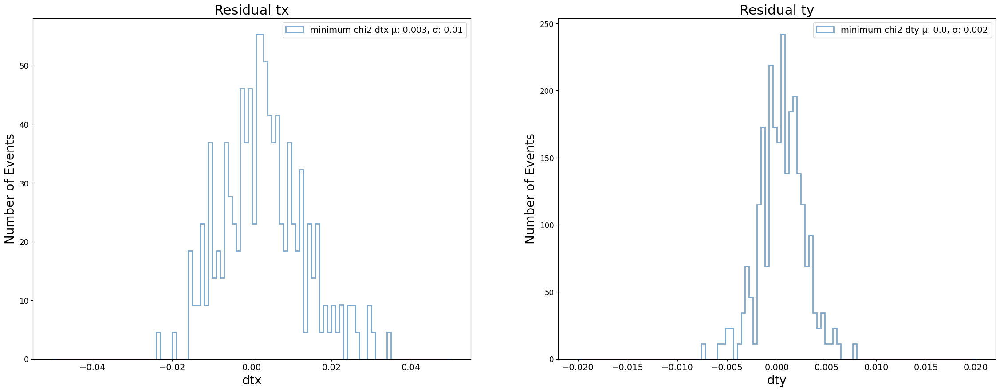

In [105]:
plt.figure(figsize=(28, 10))
plt.subplot(1, 2, 1)
bin = np.linspace(-.05, .05, 101)
plt.hist(dtx_tmp, bins=bin, alpha=0.7, histtype='step', linewidth=2, density=True, color='steelblue', label=f'minimum chi2 dtx µ: {round(np.mean(dtx_tmp), 3)}, σ: {round(np.std(dtx_tmp), 3)}')
plt.title('Residual tx', fontsize=22)
plt.ylabel('Number of Events', fontsize=20)
plt.xlabel('dtx', fontsize=20)
plt.xticks(fontsize=14)
plt.legend(fontsize=14)

plt.subplot(1, 2, 2)
bin = np.linspace(-.02, .02, 101)
plt.hist(dty_tmp, bins=bin, alpha=0.7, histtype='step', linewidth=2, density=True, color='steelblue', label=f'minimum chi2 dty µ: {round(np.mean(dty_tmp), 3)}, σ: {round(np.std(dty_tmp), 3)}')
plt.title('Residual ty', fontsize=22)
plt.ylabel('Number of Events', fontsize=20)
plt.xlabel('dty', fontsize=20)
plt.xticks(fontsize=14)
plt.legend(fontsize=14)
plt.show()

# Residual x vs. tx & Residual y vs. ty: check if there is any z shift.

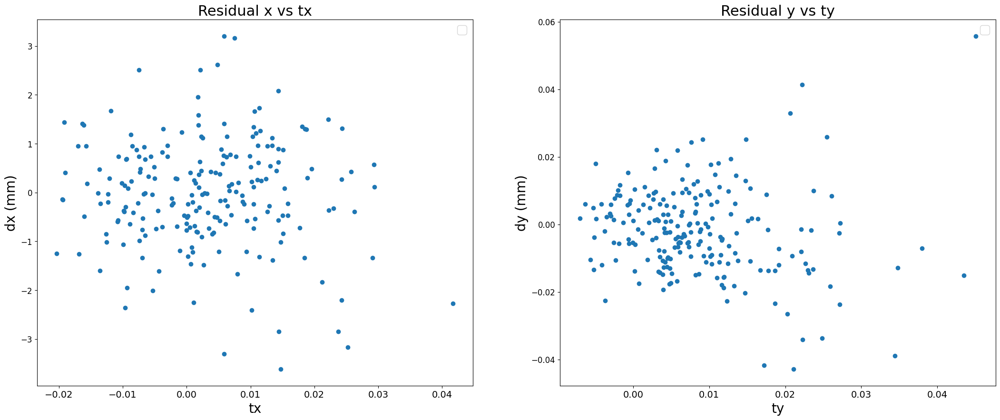

In [106]:
plt.figure(figsize=(26, 10))
plt.subplot(1, 2, 1)
bin = np.linspace(-20, 20, 201)
#plt.hist(matchb.dx, bins=bin, alpha=0.7, histtype='step', linewidth=2.5, color='purple', label=f'dx mean: {round(np.mean(matchb.dx), 5)}, standard dev: {round(np.std(matchb.dx), 5)}')
plt.scatter(np.array(ift_filter.tx)[pos_maxchi2], dx_tmp)
plt.title('Residual x vs tx', fontsize=22)
plt.ylabel('dx (mm)', fontsize=20)
plt.xlabel('tx', fontsize=20)
plt.xticks(fontsize=14)
plt.legend(fontsize=18)

plt.subplot(1, 2, 2)
bin = np.linspace(-20, 20, 201)
#plt.hist(matchb.dy, bins=bin, alpha=0.7, histtype='step', linewidth=2.5, color='purple', label=f'dy mean: {round(np.mean(matchb.dy), 5)}, standard dev: {round(np.std(matchb.dy), 5)}')
plt.scatter(np.array(ift_filter.ty)[pos_maxchi2], dy_tmp)
plt.title('Residual y vs ty', fontsize=22)
plt.ylabel('dy (mm)', fontsize=20)
plt.xlabel('ty', fontsize=20)
plt.xticks(fontsize=14)
plt.legend(fontsize=18)
plt.show()